<font size="8">Expression levels of MECP2-related genes</font>

# Environment

In [1]:
import ipynbname
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy.external as sce
from datetime import datetime
from gprofiler import GProfiler
import decoupler as dc
import triku as tk
from gprofiler import GProfiler
import os

In [2]:
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=120)
sc.logging.print_header()

scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.6.3 pandas==1.2.4 scikit-learn==1.0.1 statsmodels==0.13.0 python-igraph==0.9.7 louvain==0.7.0 pynndescent==0.5.5


In [3]:
def selectMarkers(adataObj, mList):
    """  From a list of gene names select only the genes that are present in adata.var
    """
    #Select markers present in adata
    p = adataObj.var_names[adataObj.var_names.isin(mList) == True]
    #Keep the same order as input list
    p = [x for x in mList if x in p]   
    
    #Select missing genes
    ab = set(mList).difference(set(adataObj.var_names))
    
    #Print message SISTEMA
    if len(ab) == len(mList):
        print('\nAll markers are missing')
    else:
        print('\nThe following marker genes are missing: ', ab)
        
    return(p)


In [4]:
def CustomUmap(adata, genes):
    genes = selectMarkers(adata, genes)
    sc.pl.umap(adata, color=genes, size=10, frameon=False,
               vmin='p1',  vmax='p99')

In [5]:
def CustomDA(adata, genes):
    genes = selectMarkers(adata, genes)
    sc.pl.draw_graph(adata, color=genes, size=10, frameon=False,
               vmin='p1',  vmax='p99')

In [6]:
data_folder = "./data"
result_folder = './results'

In [7]:
print(datetime.now())

2022-12-02 13:13:17.813542


## Data Load

In [8]:
adata = sc.read(os.path.join(data_folder, "annotated_dataset_human.h5ad"))

In [9]:
adata.shape 

(25321, 16240)

In [10]:
adata.obs['batch_id'].value_counts()

CNT      9599
MECP2    9124
HA       6598
Name: batch_id, dtype: int64

In [11]:
#adata.obs 
print('Number of cells:', adata.n_obs) 
print('Number of genes:', adata.n_vars) 

Number of cells: 25321
Number of genes: 16240


In [12]:
N_clusters = adata[adata.obs["celltype"].isin(['N1', 'N2', 'N3'])].copy()
N_clusters

AnnData object with n_obs × n_vars = 7693 × 16240
    obs: 'batch_id', 'sample_id', 'n_genes_by_counts', 'total_counts', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_mito', 'pct_counts_mito', 'total_counts_toxo', 'pct_counts_toxo', 'total_counts_human', 'pct_counts_human', 'total_counts_HA', 'pct_counts_HA', 'total_counts_Mecp2', 'pct_counts_Mecp2', 'n_genes', 'n_counts', 'umap_density_batch_id', 'Leiden_03', 'Leiden_04', 'Leiden_05', 'Leiden_06', 'infected', 'batch_infect', 'celltype', 'sample_infect'
    var: 'gene_ids', 'feature_types', 'ribo', 'mito', 'toxo', 'human', 'HA', 'Mecp2', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'triku_distance', 'triku_distance_uncorrected', 'triku_highly_variable'
    uns: 'Leiden_03_colors', 'Leiden_04_colors', 'Leiden_05_colors', 'Leiden_06_colors', 'batch_id_colors', 'celltype_colors', 'diffmap_evals', 'draw_graph', 'infected_colors', 'leiden', 'neighbors', 'pca', 'rank_L06', 'sample_id

# Supervised exploration of MECP2 targets in neurons


## repressed by MECP2

https://www.sciencedirect.com/science/article/pii/S0022283619305959

https://ars.els-cdn.com/content/image/1-s2.0-S0022283619305959-gr3_lrg.jpg

or upregulated in Rett syndrome

In [13]:
MECP2_markers = ['TBL1X', 'SIN3A', 'SKI', 'YY1', 'GTF2B', 'RBPJ', 'PRMT6', 'SP3', 'SOX2', 'SMARCA2',"BDNF", "FKBP5", "IGF2", "DLX5", "DLX6", "SGK1", "MPP1", "GAMT", "FXYD1"]

#for ISG15: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3587786/


#Select present markers for plotting
present_MECP2 = N_clusters.var_names[N_clusters.var_names.isin(MECP2_markers) == True]
present_MECP2 = [x for x in MECP2_markers if x in present_MECP2] #Keep the order of the markers, better way??

#Print missing markers
print('\nThe following marker genes are missing: ', set(MECP2_markers).difference(set(N_clusters.var_names)))


The following marker genes are missing:  {'DLX5', 'IGF2', 'DLX6'}


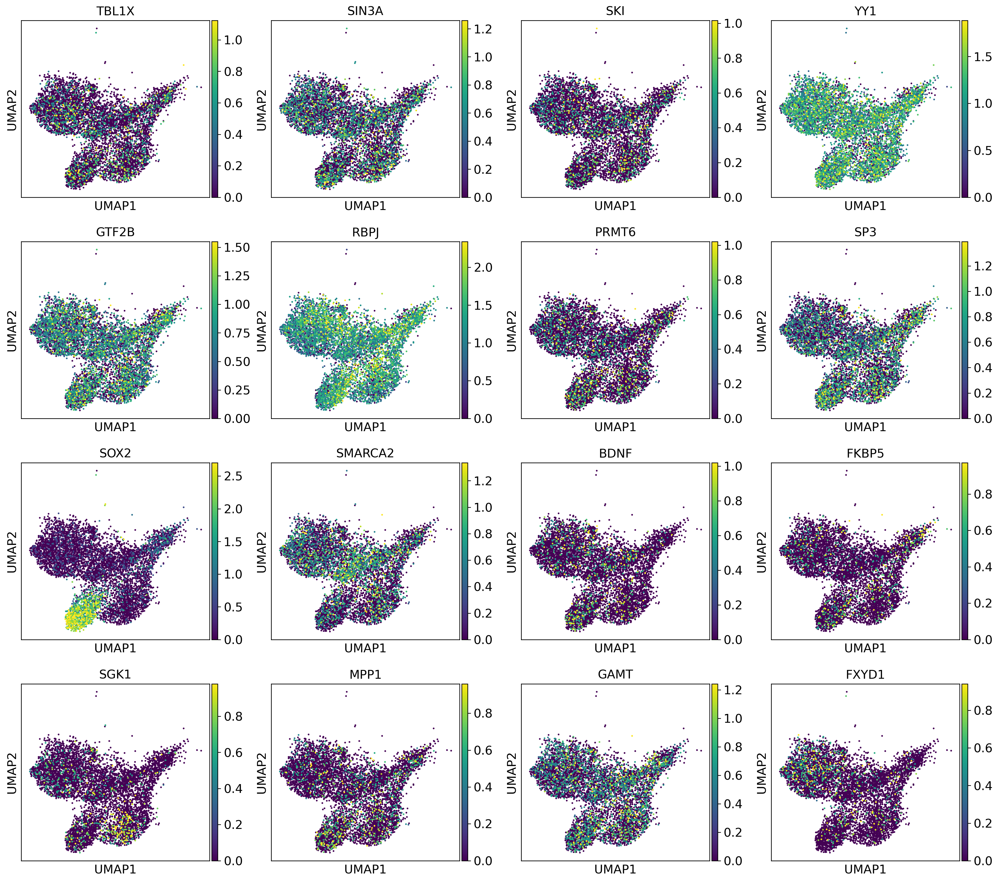

In [14]:
sc.pl.umap(N_clusters, color=present_MECP2, vmin='p1', vmax='p99')

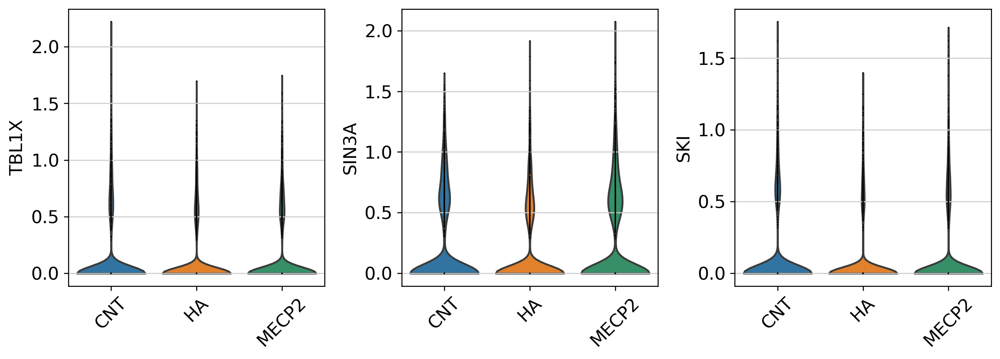

In [15]:
sc.pl.violin(N_clusters, keys=present_MECP2[0:3],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)

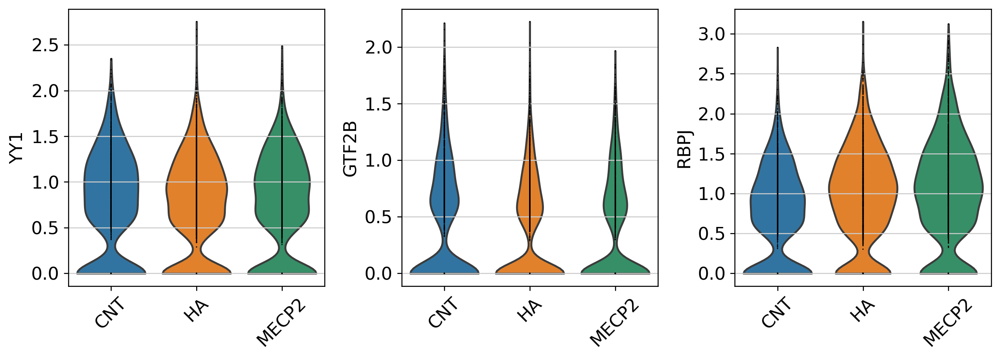

In [16]:
sc.pl.violin(N_clusters, keys=present_MECP2[3:6],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


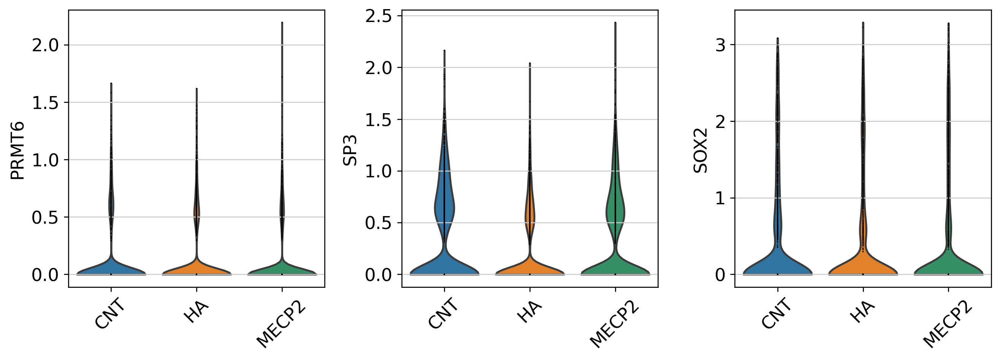

In [17]:
sc.pl.violin(N_clusters, keys=present_MECP2[6:9],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


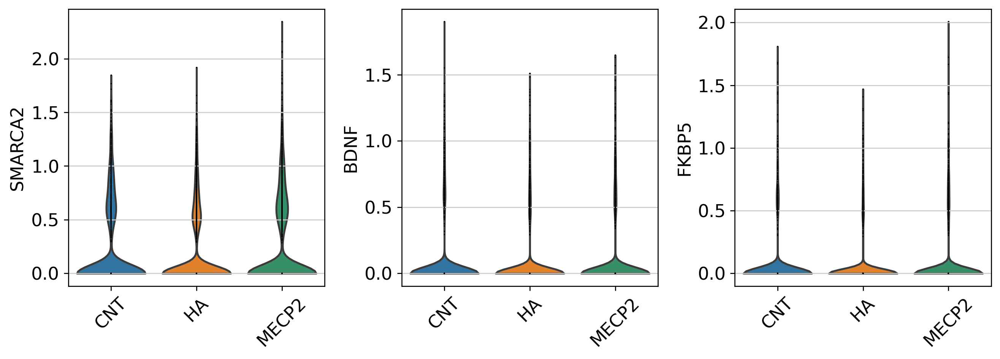

In [18]:
sc.pl.violin(N_clusters, keys=present_MECP2[9:12],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


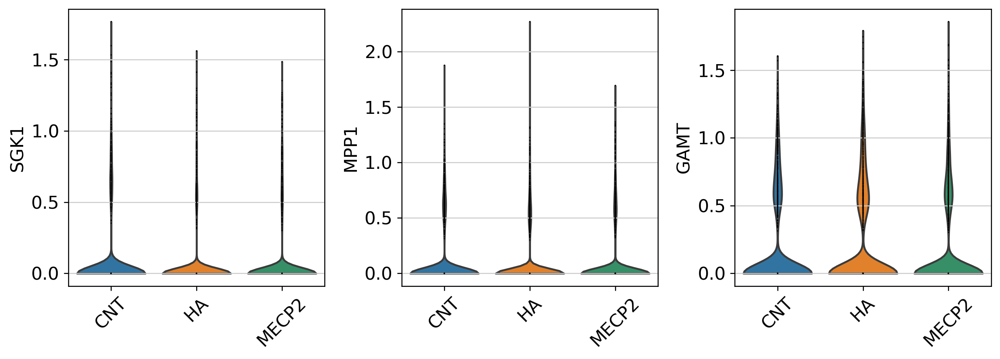

In [19]:
sc.pl.violin(N_clusters, keys=present_MECP2[12:15],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


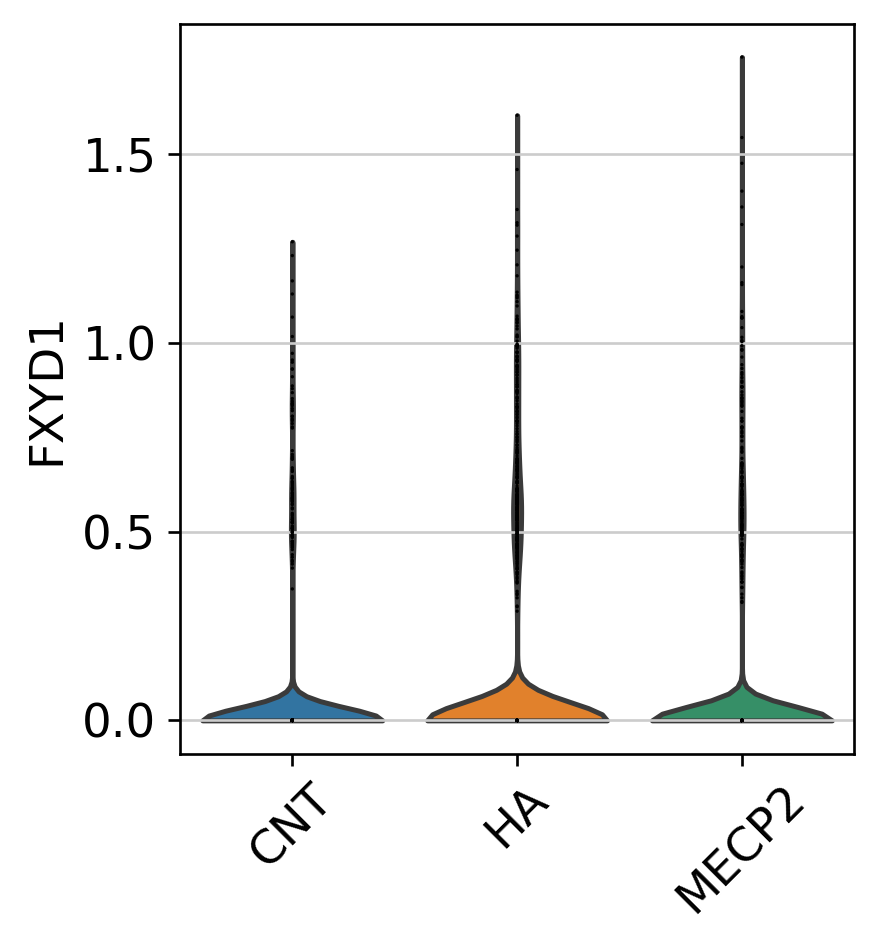

In [20]:
sc.pl.violin(N_clusters, keys=present_MECP2[15:18],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


## activated by MECP2

https://www.sciencedirect.com/science/article/pii/S0022283619305959

https://ars.els-cdn.com/content/image/1-s2.0-S0022283619305959-gr3_lrg.jpg

or downregulated in Rett Syndrome

https://ojrd.biomedcentral.com/articles/10.1186/s13023-016-0545-5/tables/3

In [21]:
MECP2_markers = ['CREB1', 'MYCN',"UBE3A", "GRID1", "MECP2"]

#for ISG15: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3587786/


#Select present markers for plotting
present_MECP2 = N_clusters.var_names[N_clusters.var_names.isin(MECP2_markers) == True]
present_MECP2 = [x for x in MECP2_markers if x in present_MECP2] #Keep the order of the markers, better way??

#Print missing markers
print('\nThe following marker genes are missing: ', set(MECP2_markers).difference(set(N_clusters.var_names)))


The following marker genes are missing:  set()


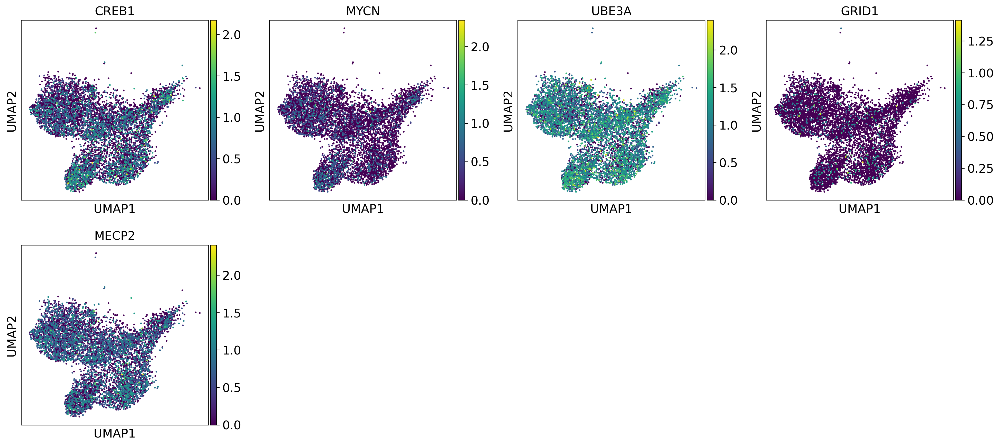

In [22]:
sc.pl.umap(N_clusters, color=present_MECP2)

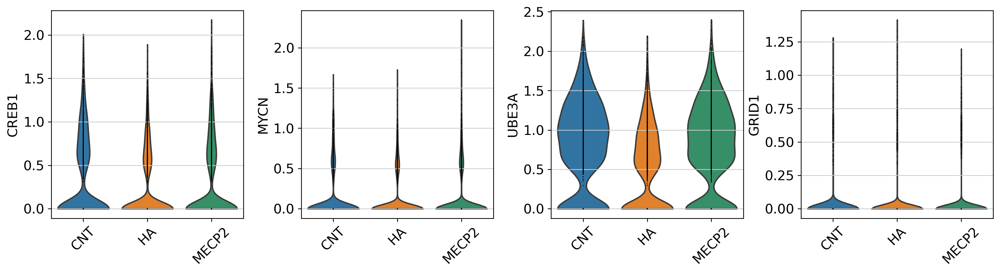

In [23]:
sc.pl.violin(N_clusters, keys=present_MECP2[0:4],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)

# Supervised exploration of "Transcriptional Regulation by MECP2" reactome pathway in neurons

In [24]:
MECP2_markers = ["MECP2","MOBP","SGK1","RBFOX1","CREB1","MEF2C","PPARG","MIR137","GAMT","PVALB",
                 "MIR132","IRAK1","BDNF","CRH","SST","DLL1","GAD2","GAD1","PTPN1","NOTCH1",
                 "MET","OPRK1","PTPN4","GPRIN1","TRPC3","OPRM1","GRIN2B","SLC2A3","GRIN2A","GRIA2",
                 "FKBP5","PTEN"]

#Select present markers for plotting
present_MECP2 = N_clusters.var_names[N_clusters.var_names.isin(MECP2_markers) == True]
present_MECP2 = [x for x in MECP2_markers if x in present_MECP2] #Keep the order of the markers, better way??

#Print missing markers
print('\nThe following marker genes are missing: ', set(MECP2_markers).difference(set(N_clusters.var_names)))


The following marker genes are missing:  {'MIR137', 'PPARG', 'CRH', 'PVALB', 'MET', 'MIR132', 'MOBP'}


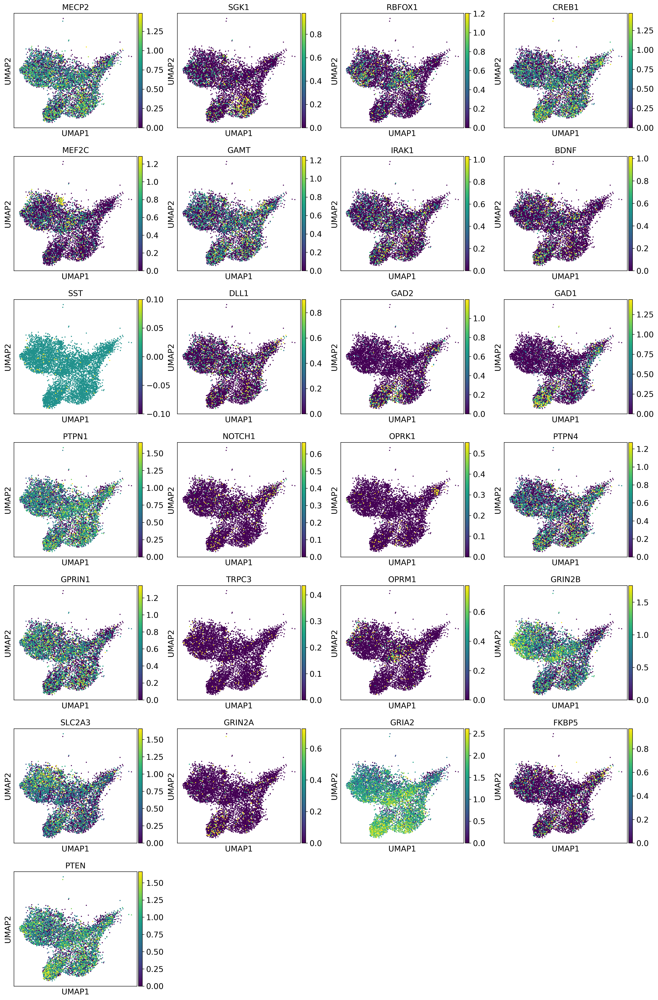

In [25]:
sc.pl.umap(N_clusters, color=present_MECP2, vmin='p1', vmax='p99')

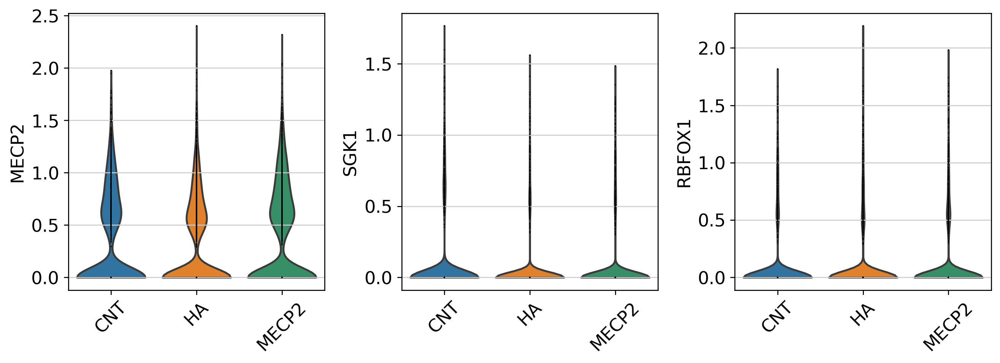

In [26]:
sc.pl.violin(N_clusters, keys=present_MECP2[0:3],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)

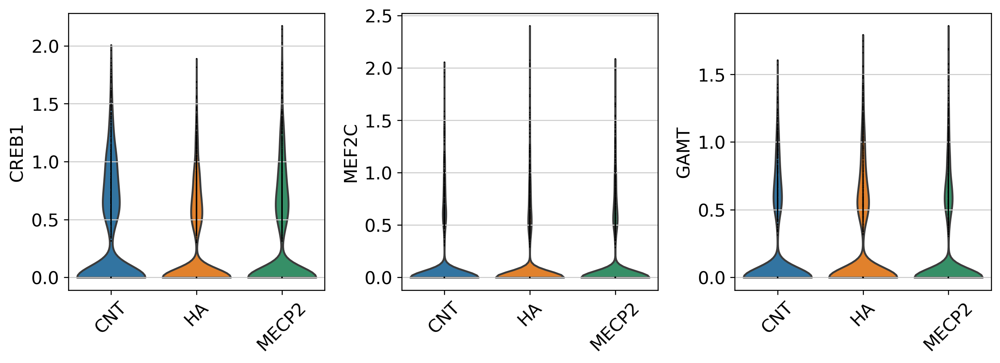

In [27]:
sc.pl.violin(N_clusters, keys=present_MECP2[3:6],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


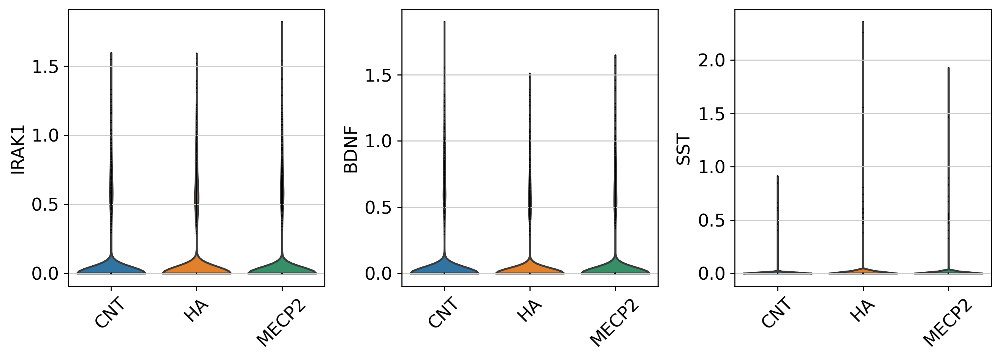

In [28]:
sc.pl.violin(N_clusters, keys=present_MECP2[6:9],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


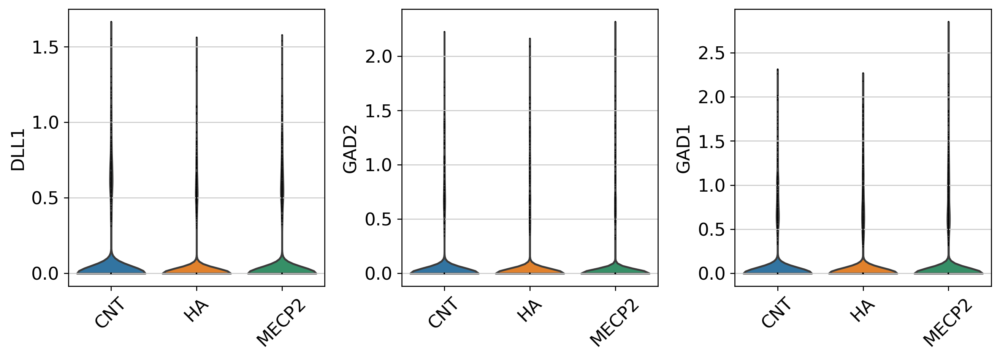

In [29]:
sc.pl.violin(N_clusters, keys=present_MECP2[9:12],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


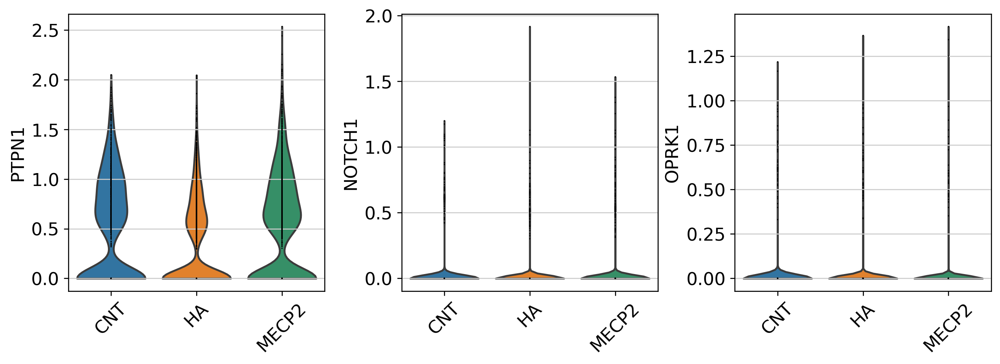

In [30]:
sc.pl.violin(N_clusters, keys=present_MECP2[12:15],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


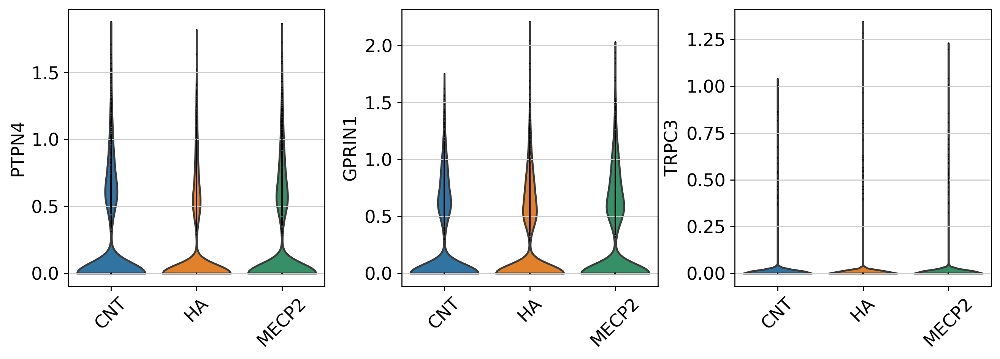

In [31]:
sc.pl.violin(N_clusters, keys=present_MECP2[15:18],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


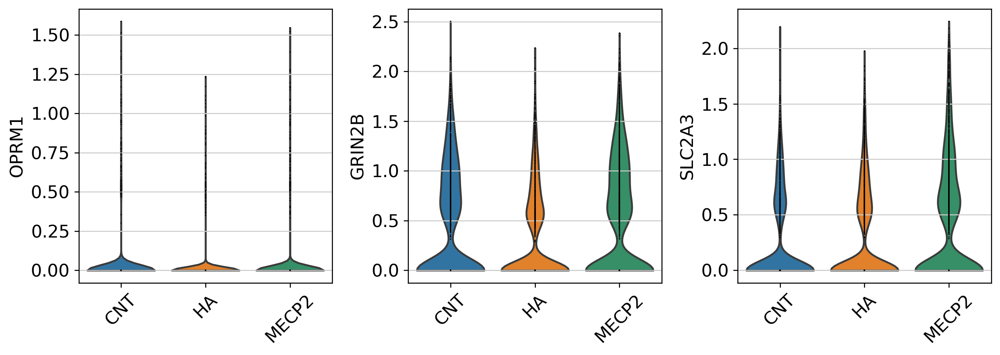

In [32]:
sc.pl.violin(N_clusters, keys=present_MECP2[18:21],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


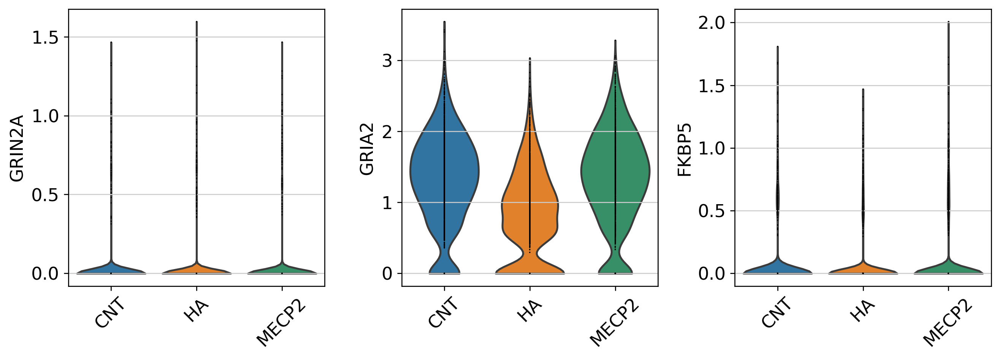

In [33]:
sc.pl.violin(N_clusters, keys=present_MECP2[21:24],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


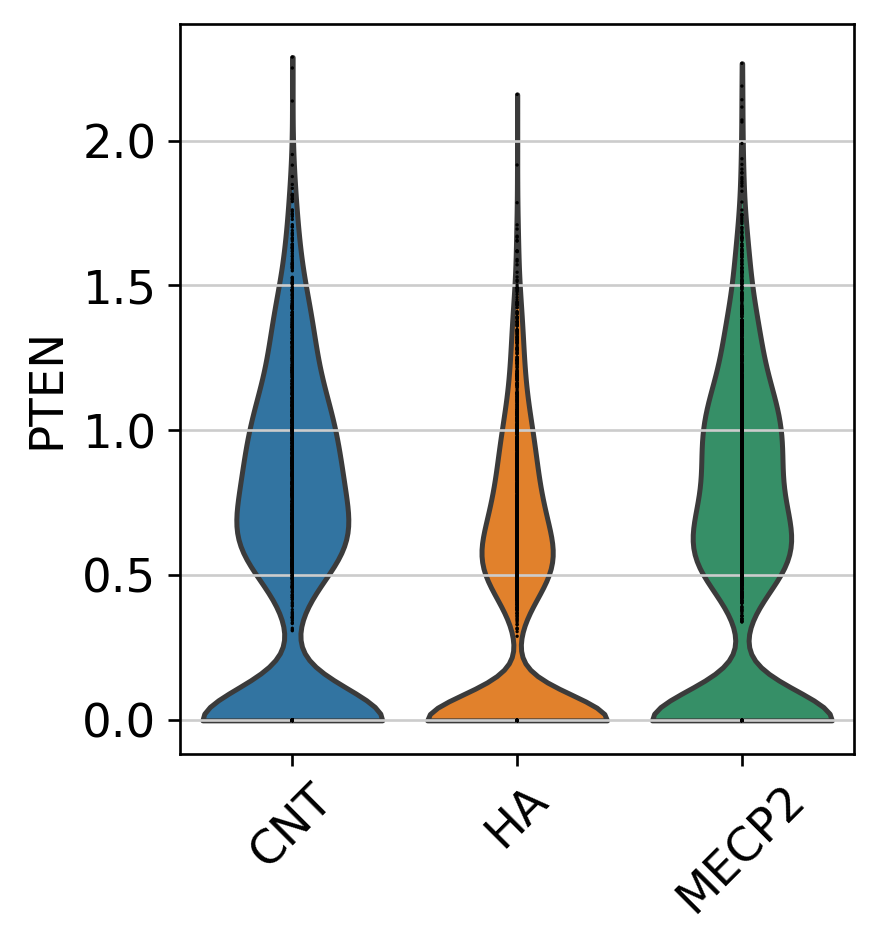

In [34]:
sc.pl.violin(N_clusters, keys=present_MECP2[24:27],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


# Supervised exploration of "Transcriptional Regulation by MECP2" reactome pathway in infeccted neurons

In [35]:
only_infected = N_clusters[N_clusters.obs["infected"].isin(["True"]),:]

MECP2_markers = ["MECP2","MOBP","SGK1","RBFOX1","CREB1","MEF2C","PPARG","MIR137","GAMT","PVALB",
                 "MIR132","IRAK1","BDNF","CRH","SST","DLL1","GAD2","GAD1","PTPN1","NOTCH1",
                 "MET","OPRK1","PTPN4","GPRIN1","TRPC3","OPRM1","GRIN2B","SLC2A3","GRIN2A","GRIA2",
                 "FKBP5","PTEN"]

#Select present markers for plotting
present_MECP2 = only_infected.var_names[only_infected.var_names.isin(MECP2_markers) == True]
present_MECP2 = [x for x in MECP2_markers if x in present_MECP2] #Keep the order of the markers, better way??

#Print missing markers
print('\nThe following marker genes are missing: ', set(MECP2_markers).difference(set(only_infected.var_names)))


The following marker genes are missing:  {'MIR137', 'PPARG', 'CRH', 'PVALB', 'MET', 'MIR132', 'MOBP'}


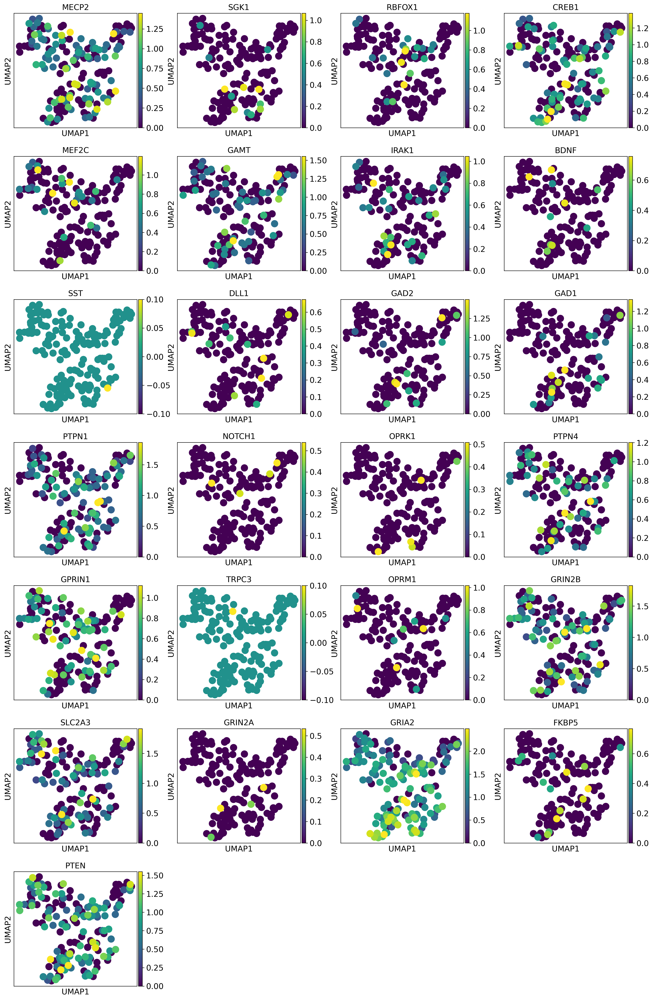

In [36]:
sc.pl.umap(only_infected, color=present_MECP2, vmin='p1', vmax='p99')

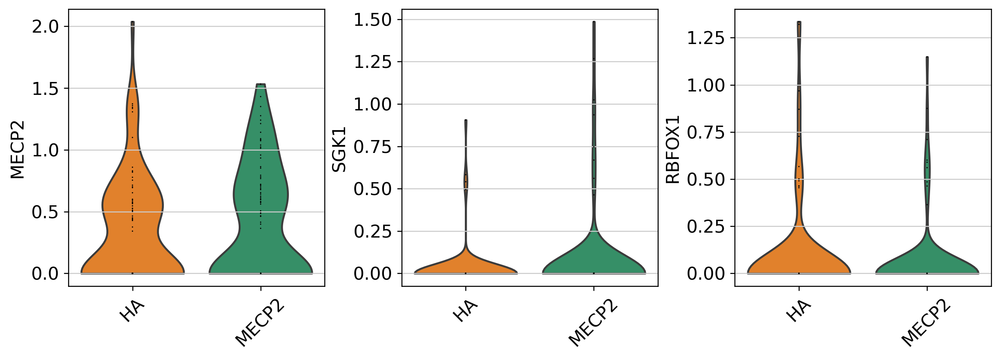

In [37]:
sc.pl.violin(only_infected, keys=present_MECP2[0:3],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)

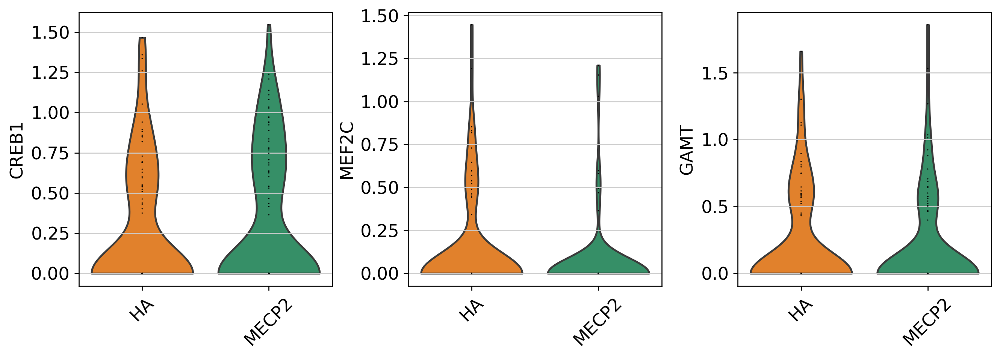

In [38]:
sc.pl.violin(only_infected, keys=present_MECP2[3:6],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


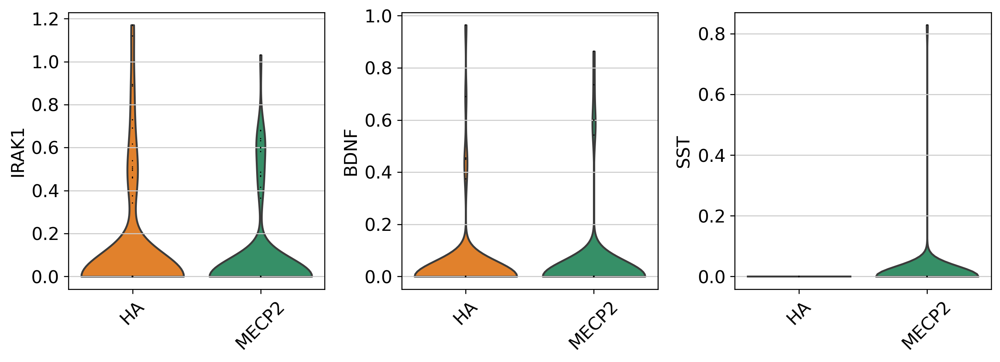

In [39]:
sc.pl.violin(only_infected, keys=present_MECP2[6:9],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


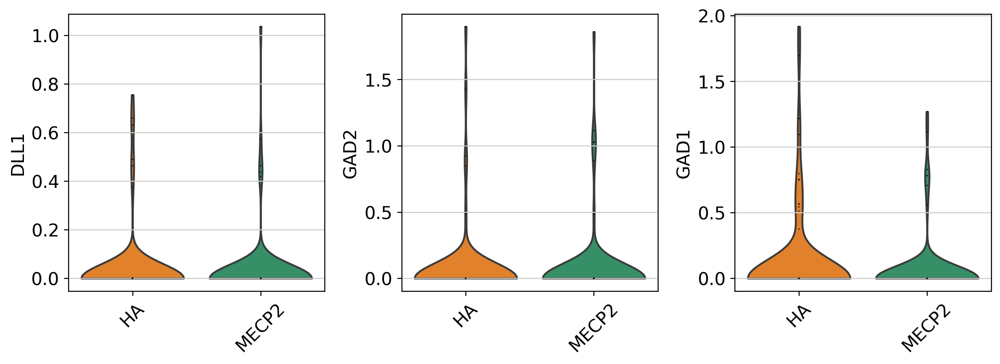

In [40]:
sc.pl.violin(only_infected, keys=present_MECP2[9:12],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


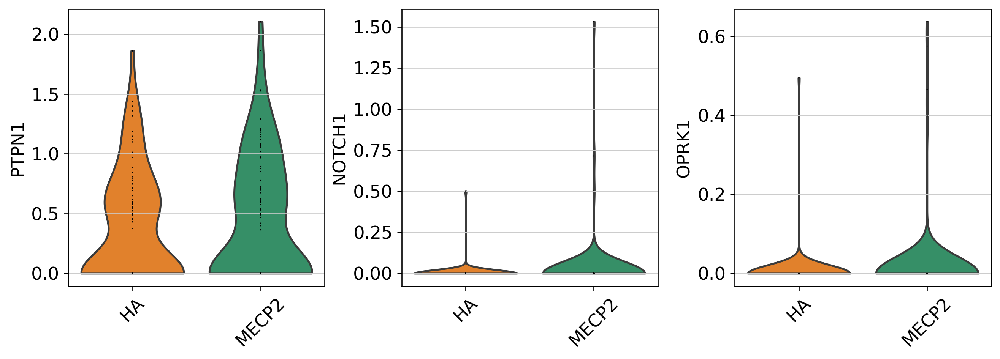

In [41]:
sc.pl.violin(only_infected, keys=present_MECP2[12:15],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


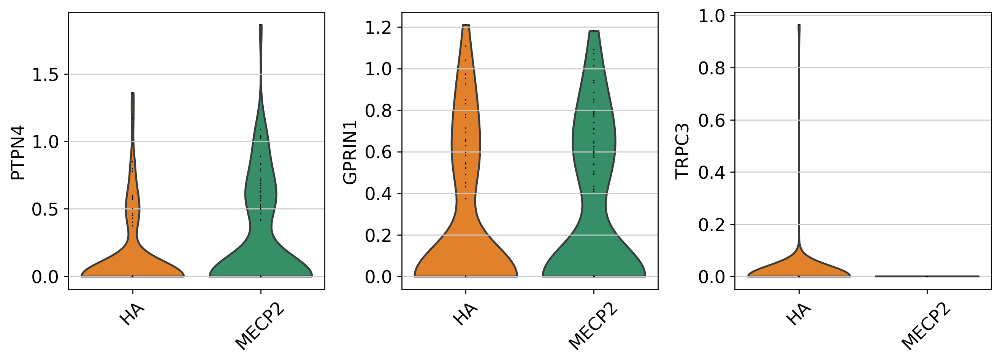

In [42]:
sc.pl.violin(only_infected, keys=present_MECP2[15:18],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


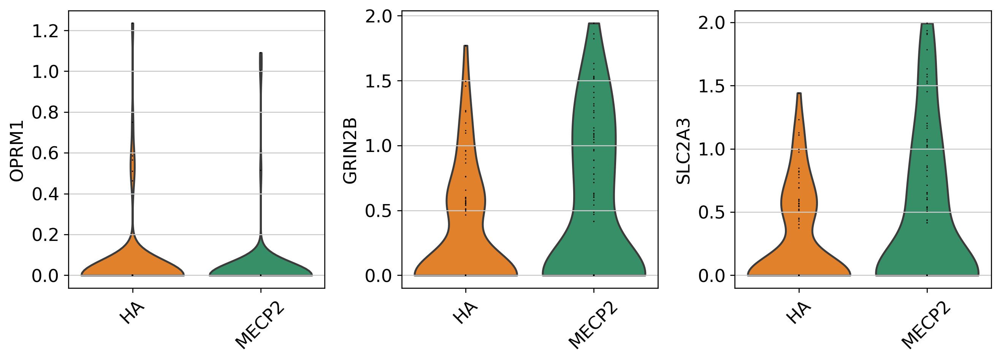

In [43]:
sc.pl.violin(only_infected, keys=present_MECP2[18:21],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


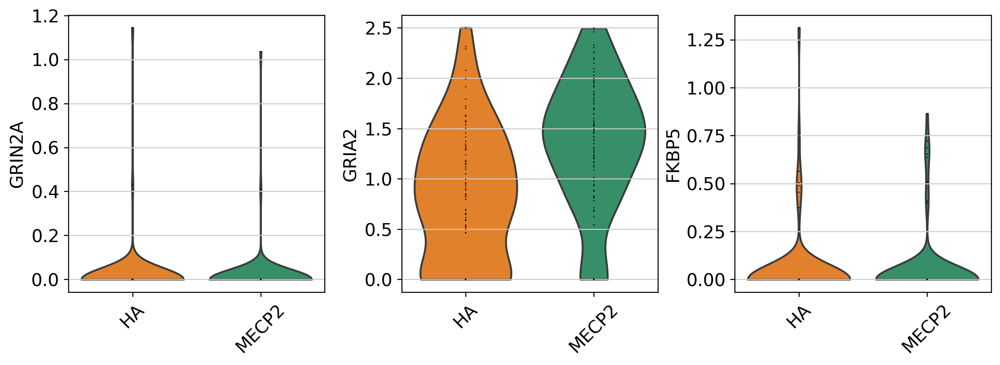

In [44]:
sc.pl.violin(only_infected, keys=present_MECP2[21:24],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


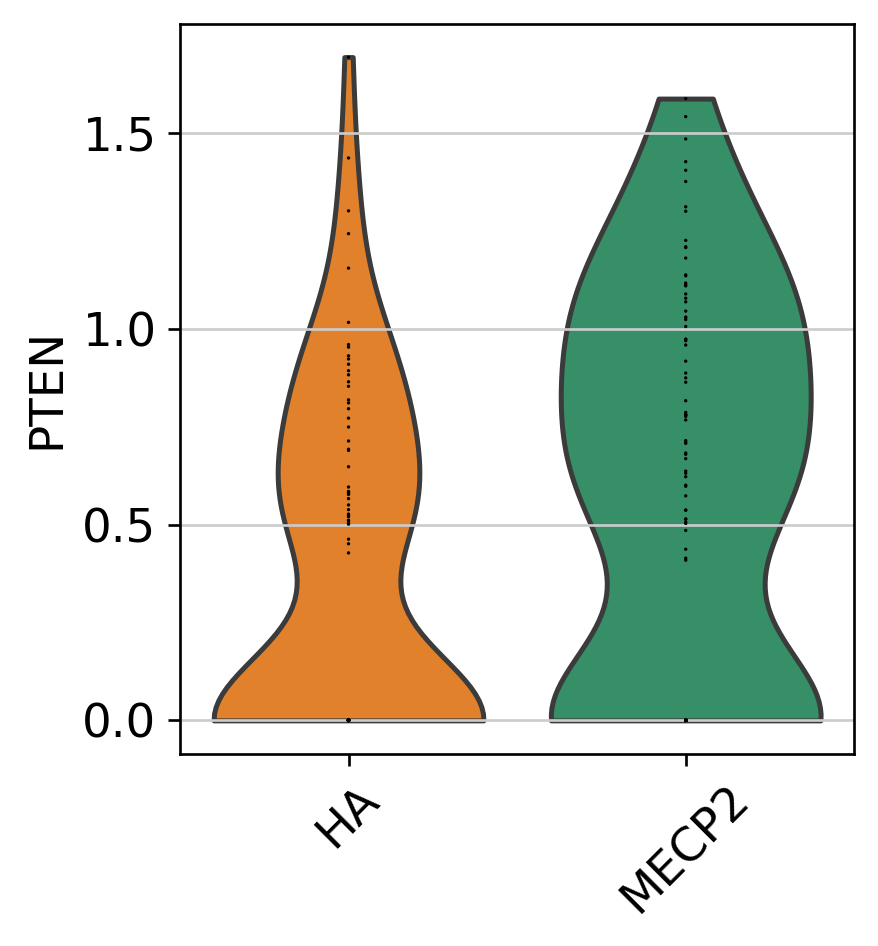

In [45]:
sc.pl.violin(only_infected, keys=present_MECP2[24:27],
             jitter=False, multi_panel=True, groupby='batch_id', rotation=45)


# Saving

## Timestamp finished computations

In [46]:
print(datetime.now())

2022-12-02 13:13:56.724776


## Save python and html version of notebook

In [47]:
nb_fname = ipynbname.name()
nb_fname

'04-MECP2_related_genes'

In [48]:
%%bash -s "$nb_fname"
sleep 120
jupyter nbconvert "$1".ipynb --to="python" --ClearOutputPreprocessor.enabled=True
jupyter nbconvert "$1".ipynb --to="html"

[NbConvertApp] Converting notebook 04-MECP2_related_genes.ipynb to python
[NbConvertApp] Writing 9689 bytes to 04-MECP2_related_genes.py
[NbConvertApp] Converting notebook 04-MECP2_related_genes.ipynb to html
[NbConvertApp] Writing 25839165 bytes to 04-MECP2_related_genes.html
